# importing requisite liberaries

In [134]:
import pandas as pd
import plotly.express as px
import imdlib as imd
import matplotlib.pyplot as plt
from sklearn.preprocessing import LabelEncoder
import seaborn as sns
import numpy as np

from pylab import rcParams

from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa import api as smt
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.stattools import adfuller

from sklearn.preprocessing import StandardScaler

from utils.metrics import evaluate
from tqdm import tqdm
from statsmodels.tsa.holtwinters import ExponentialSmoothing, SimpleExpSmoothing
from sklearn import linear_model, svm
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import make_scorer, mean_squared_error
from sklearn.model_selection import GridSearchCV, cross_val_score

import lightgbm as lgb
import pmdarima as pm
import tensorflow as tf
import xgboost as xgb

import joblib


# importing AC_Data

In [2]:
df=pd.read_csv("AC_Data.csv")
df.rename(columns={"0":"time_block"},inplace=True)


# importing manual framed holiday data

In [3]:
hf=pd.read_excel("holiday_2019.xlsx")

# using imdlib for extracting historic weather data

In [4]:
#start_yr = 2019
#end_yr = 2019
#variable = ['rain','tmin','tmax']
#for i in variable:
    #imd.get_data(i, start_yr, end_yr, fn_format='yearwise')
#rain = imd.open_data(variable[0], start_yr, end_yr,'yearwise')
#tmin = imd.open_data(variable[1], start_yr, end_yr,'yearwise')
#tmax = imd.open_data(variable[2], start_yr, end_yr,'yearwise')
    
#lat,lon=28.4595,77.0266   #defining latitude & longitude of gurugram


In [5]:
#rain.to_csv('rain.csv', lat, lon)
#tmin.to_csv('tmin.csv', lat, lon)
#tmax.to_csv('tmax.csv', lat, lon)

In [6]:
rain=pd.read_csv("rain_28.46_77.03.csv")
tmin=pd.read_csv("tmin_28.46_77.03.csv")
tmax=pd.read_csv("tmax_28.46_77.03.csv")

In [7]:
rain.rename(columns={"DateTime":"date","28.4595 77.0266":"rain"},inplace=True)
tmin.rename(columns={"DateTime":"date","28.4595 77.0266":"tmin"},inplace=True)
tmax.rename(columns={"DateTime":"date","28.4595 77.0266":"tmax"},inplace=True)

In [8]:
wf_0=pd.merge(rain,tmin,on="date")
wf=pd.merge(wf_0,tmax,on="date")
wf["temp"]=(wf["tmin"]+wf["tmax"])/2
wf.drop(columns=["tmin","tmax"],inplace=True)
wf["date"]=pd.to_datetime(wf["date"])

# adding parameters for timestamp

In [9]:
df.fillna(method="bfill",inplace=True)

In [10]:
df["time_block"]=pd.to_datetime(df["time_block"])

In [11]:
df['weekday'] = df['time_block'].dt.weekday
df['date'] = df['time_block'].dt.date
df["time"]= df["time_block"].dt.time

In [12]:
df["date"]=pd.to_datetime(df["date"])

In [13]:
pd.set_option('display.max_columns', None)

In [14]:
df=pd.merge(df,hf,on="date",how="left")

In [15]:
df=pd.merge(df,wf,on="date",how="left")

In [16]:
df["holiday"].fillna("0",inplace=True)

In [17]:
x=[]
for i in df["holiday"]:
    if (i=='0'):
        x.append(0)
        
    else:
        
        x.append(1)
df["holiday"]=x
    
    

In [18]:
df.sort_values(by="time_block",inplace=True)

In [19]:
df["time"]=df["time"].astype("str")

In [20]:
df

,time_block,AC 1,AC 2,AC 3,AC 4,AC 5,AC 6,AC 7,AC 8,AC 9,AC 10,AC 11,AC 12,AC 13,AC 14,AC 15,AC 16,AC 17,AC 18,weekday,date,time,holiday,rain,temp
0,2019-08-01 00:00:00,7.518632,8.788315,0.000000,0.000000,2.617045,4.079041,2.782276,4.624447,5.222060,2.151238,1.585072,0.560373,3.142941,2.749470,5.417774,4.113460,3.305072,6.735981,3,2019-08-01,00:00:00,0,0.0,30.9869
1,2019-08-01 00:01:00,7.426114,8.940615,0.000000,0.000000,2.581625,3.781231,2.529366,5.057423,5.349465,2.414715,2.168184,1.818730,3.085110,2.720484,3.302422,3.986483,3.220588,6.379500,3,2019-08-01,00:01:00,0,0.0,30.9869
2,2019-08-01 00:02:00,7.426114,8.940615,0.000000,0.000000,2.581625,3.781231,2.529366,5.057423,5.349465,2.414715,2.168184,1.818730,3.085110,2.720484,3.302422,3.986483,3.220588,6.379500,3,2019-08-01,00:02:00,0,0.0,30.9869
3,2019-08-01 00:03:00,7.052986,9.161103,0.000000,0.000000,2.592095,3.800127,2.332304,6.322521,3.995392,2.237114,3.345624,2.310409,3.132799,2.676861,3.539026,3.797881,3.131560,6.363475,3,2019-08-01,00:03:00,0,0.0,30.9869
4,2019-08-01 00:04:00,7.052986,9.161103,0.000000,0.000000,2.592095,3.800127,2.332304,6.322521,3.995392,2.237114,3.345624,2.310409,3.132799,2.676861,3.539026,3.797881,3.131560,6.363475,3,2019-08-01,00:04:00,0,0.0,30.9869
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
87835,2019-09-30 23:55:00,0.000000,6.122385,2.192198,2.083315,1.046250,0.000000,3.668421,3.006311,3.614301,1.860847,5.019769,3.154221,3.648026,2.439526,4.062719,1.854352,3.027539,7.259989,0,2019-09-30,23:55:00,0,0.0,26.4364
87836,2019-09-30 23:56:00,1.209176,6.152532,2.211421,0.000000,1.448103,0.000000,3.151248,2.871690,3.417942,2.185493,5.174168,2.772349,3.786657,2.060023,4.057525,1.870886,2.991946,7.134647,0,2019-09-30,23:56:00,0,0.0,26.4364
87837,2019-09-30 23:57:00,1.209176,6.152532,2.211421,0.000000,1.448103,0.000000,3.151248,2.871690,3.417942,2.185493,5.174168,2.772349,3.786657,2.060023,4.057525,1.870886,2.991946,7.134647,0,2019-09-30,23:57:00,0,0.0,26.4364
87838,2019-09-30 23:58:00,1.430442,6.078281,1.891162,0.000000,1.577491,4.364239,3.126339,3.287224,3.986978,2.013912,4.821829,3.363855,3.380110,1.949240,4.026304,1.862166,3.009434,7.179719,0,2019-09-30,23:58:00,0,0.0,26.4364


In [21]:
cat_code=LabelEncoder()
df["time"]=cat_code.fit_transform(df["time"])

In [22]:
df.drop(columns=["date"],inplace=True)

In [23]:
#let's create a column depicting aggregate consumption
df["sum"]=0
for i in range(1,19):
    df["sum"]=df["sum"]+df.iloc[:,i]

In [24]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 87840 entries, 0 to 87839
Data columns (total 25 columns):
 #   Column      Non-Null Count  Dtype         
---  ------      --------------  -----         
 0   time_block  87840 non-null  datetime64[ns]
 1   AC 1        87840 non-null  float64       
 2   AC 2        87840 non-null  float64       
 3   AC 3        87840 non-null  float64       
 4   AC 4        87840 non-null  float64       
 5   AC 5        87840 non-null  float64       
 6   AC 6        87840 non-null  float64       
 7   AC 7        87840 non-null  float64       
 8   AC 8        87840 non-null  float64       
 9   AC 9        87840 non-null  float64       
 10  AC 10       87840 non-null  float64       
 11  AC 11       87840 non-null  float64       
 12  AC 12       87840 non-null  float64       
 13  AC 13       87840 non-null  float64       
 14  AC 14       87840 non-null  float64       
 15  AC 15       87840 non-null  float64       
 16  AC 16       87840 non-

In [25]:
df.describe()

,AC 1,AC 2,AC 3,AC 4,AC 5,AC 6,AC 7,AC 8,AC 9,AC 10,AC 11,AC 12,AC 13,AC 14,AC 15,AC 16,AC 17,AC 18,weekday,time,holiday,rain,temp,sum
count,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.000000,87840.00000,87840.000000,87840.000000,87840.000000,87840.000000
mean,2.376846,3.858297,2.562241,2.392101,1.418876,2.516958,2.976276,2.542694,3.177230,1.535206,2.403317,2.694102,4.272572,2.911153,4.039908,2.795755,4.214967,6.457026,3.049180,719.50000,0.049180,3.745377,30.000440,55.145525
std,2.275693,2.547314,1.490684,1.796850,0.769515,1.657816,1.475383,1.507089,1.525478,0.687323,1.555226,1.439830,1.851297,1.460037,2.019032,1.608639,1.134200,2.329829,2.011668,415.69446,0.216246,8.301983,1.394993,12.756848
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,26.240650,0.000000
25%,0.000000,2.109164,1.700829,1.255017,0.968402,1.536125,2.188468,1.758497,2.291252,1.115012,1.588982,1.943268,3.254433,1.848018,3.020803,1.872254,3.749032,4.010320,1.000000,359.75000,0.000000,0.000000,29.245550,47.276502
50%,2.090217,3.784209,2.482899,2.308067,1.378475,2.665071,3.003756,2.604897,3.075877,1.501676,2.350793,2.725485,4.211054,2.783795,3.994634,2.669432,4.611294,7.130620,3.000000,719.50000,0.000000,0.112700,30.291050,54.611862
75%,3.660712,5.453593,3.436845,3.472850,1.869069,3.620559,3.893004,3.493405,4.089876,1.961844,3.256044,3.565453,5.375952,3.822174,5.254503,3.693511,4.959440,8.316685,5.000000,1079.25000,0.000000,1.136400,31.056200,62.114934
max,11.194789,11.147141,8.430909,9.879500,5.495358,9.929291,9.356776,9.331506,10.026747,4.625030,10.363151,9.887306,9.796393,9.054969,10.349998,10.654430,5.950261,11.040031,6.000000,1439.00000,1.000000,34.769400,32.317900,130.064581


In [26]:
# on observing mean,it can be concluded "AC 18" is consuming maximum units whereas "AC 5" is consuming least units
#let's plot them

In [27]:
plt.figure(figsize=(16,9))
fig=px.line(df,x="time_block",y="AC 1")
fig.update_xaxes(rangeslider_visible=True)
fig.show()

<Figure size 1152x648 with 0 Axes>

In [28]:
plt.figure(figsize=(16,9))
fig=px.line(df,x="time_block",y="AC 18")
fig.update_xaxes(rangeslider_visible=True)
fig.show()

<Figure size 1152x648 with 0 Axes>

In [29]:
plt.figure(figsize=(16,9))
fig=px.line(df,x="time_block",y="AC 5")
fig.update_xaxes(rangeslider_visible=True)
fig.show()

<Figure size 1152x648 with 0 Axes>

In [30]:
plt.figure(figsize=(16,9))
fig=px.line(df,x="time_block",y="sum")
fig.update_xaxes(rangeslider_visible=True)
fig.show()

<Figure size 1152x648 with 0 Axes>

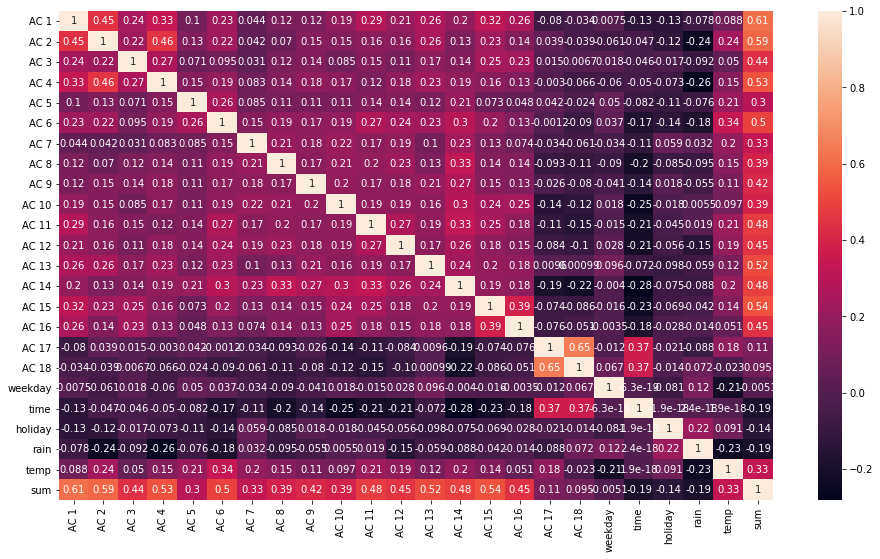

In [31]:
plt.figure(figsize=(16,9))
ax = sns.heatmap(df.corr(), annot=True)


In [32]:
# correlation matrix suggest AC_1 to AC_16 are fairly correlated with the sum so analysing AC_sum can be assume equivalent to analysis of AC_1 to AC_16.

#AC_17 & AC_18 are quite similar as the are not correlated with any of the ACs among AC_1 to AC_16 and neither with the AC_sum.Moreover, they are failrly related among themself.
#And AC_17 & AC_18 are failrly correlated with time too.

#AC_1 to AC_16 are fairly normally distributed as theirs means & medin are close enough whereas AC_17 & AC_18 are fairly +vly skewed.


In [33]:
df["avg_1"]=0
df["avg_2"]=0
for i in range(1,19):
    if (i<17):
        df["avg_1"]=df["avg_1"]+df.iloc[:,i]
    else:
        df["avg_2"]=df["avg_2"]+df.iloc[:,i]
df["avg_1"]=df["avg_1"]/16
df["avg_2"]=df["avg_2"]/2

In [34]:
#let's understand the behaviour of sum_1 & sum_2 via plotting them with different sampling frequency

In [35]:
plt.figure(figsize=(16,9))
fig=px.line(df.iloc[:2880],y=["avg_1","avg_2"])
fig.update_xaxes(rangeslider_visible=True)
fig.show()

<Figure size 1152x648 with 0 Axes>

In [36]:
df.set_index('time_block', inplace=True)

In [37]:
# Looking for hourly profile
resample = df.resample('H')
hourly_mean = resample.mean()
plt.figure(figsize=(16,9))
fig=px.line(hourly_mean,y=["avg_1","avg_2"])
fig.update_xaxes(rangeslider_visible=True)
fig.show()

<Figure size 1152x648 with 0 Axes>

In [38]:
# Looking for daily seasonality
resample = df.resample('D')
daily_mean = resample.mean()
plt.figure(figsize=(16,9))
fig=px.line(daily_mean,y=["avg_1","avg_2","weekday","holiday"])
fig.update_xaxes(rangeslider_visible=True)
fig.show()

<Figure size 1152x648 with 0 Axes>

In [39]:
# Looking for weekly seasonality
resample = df.resample('W')
weekly_mean = resample.mean()
plt.figure(figsize=(16,9))
fig=px.line(weekly_mean,y=["avg_1","avg_2"])
fig.update_xaxes(rangeslider_visible=True)
fig.show()

<Figure size 1152x648 with 0 Axes>

<AxesSubplot:>

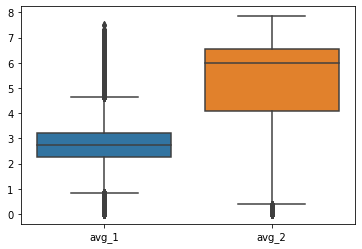

In [40]:
sns.boxplot(data=df[["avg_1","avg_2"]])

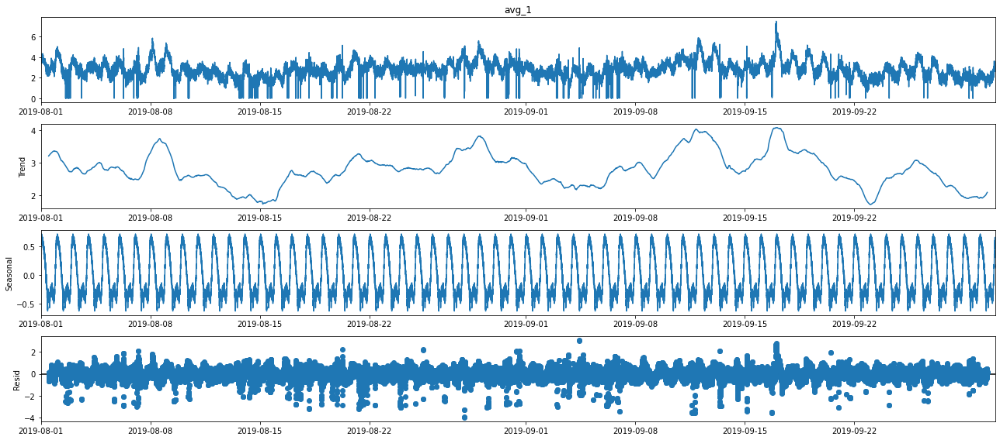

<Figure size 4000x1600 with 0 Axes>

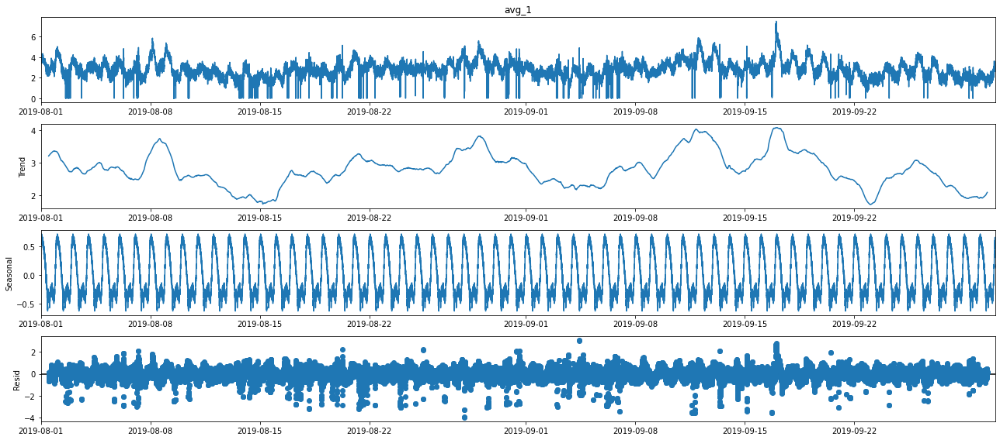

In [42]:
rcParams['figure.figsize'] = 18, 8
plt.figure(num=None, figsize=(50, 20), dpi=80, facecolor='w', edgecolor='k')
series_1 = df["avg_1"]
result = seasonal_decompose(series_1, model='additive',period=1440)
result.plot()

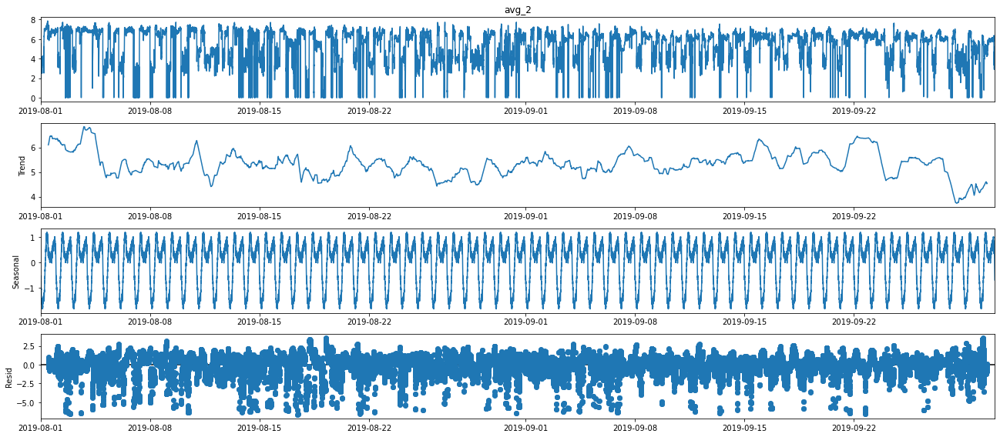

<Figure size 4000x1600 with 0 Axes>

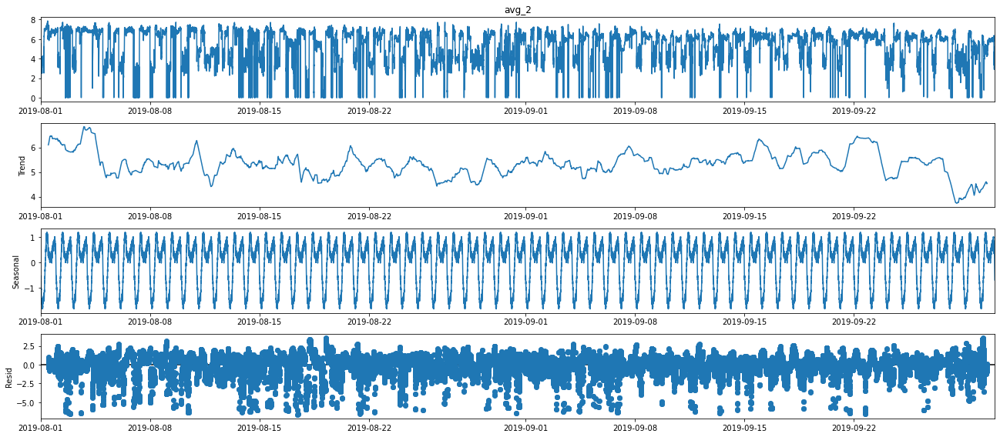

In [45]:
rcParams['figure.figsize'] = 18, 8
plt.figure(num=None, figsize=(50, 20), dpi=80, facecolor='w', edgecolor='k')
series_2 = df["avg_2"]
result = seasonal_decompose(series_2, model='additive',period=1440)
result.plot()

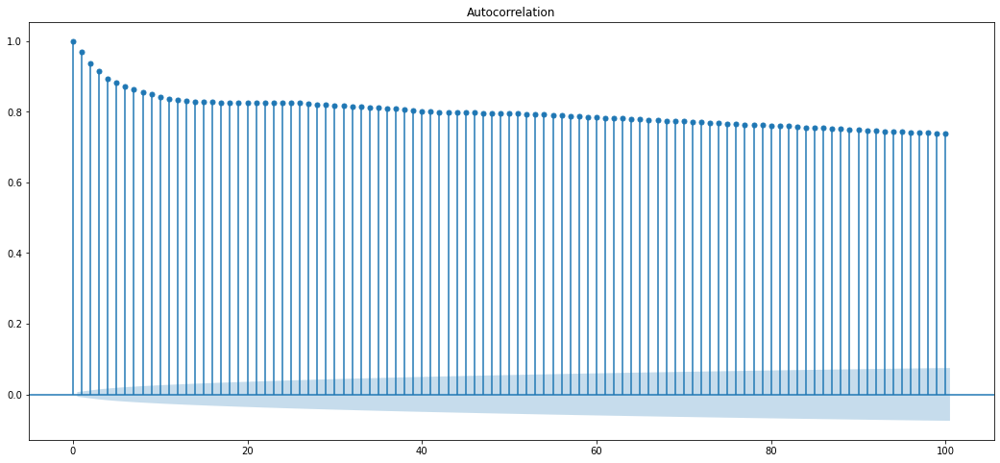

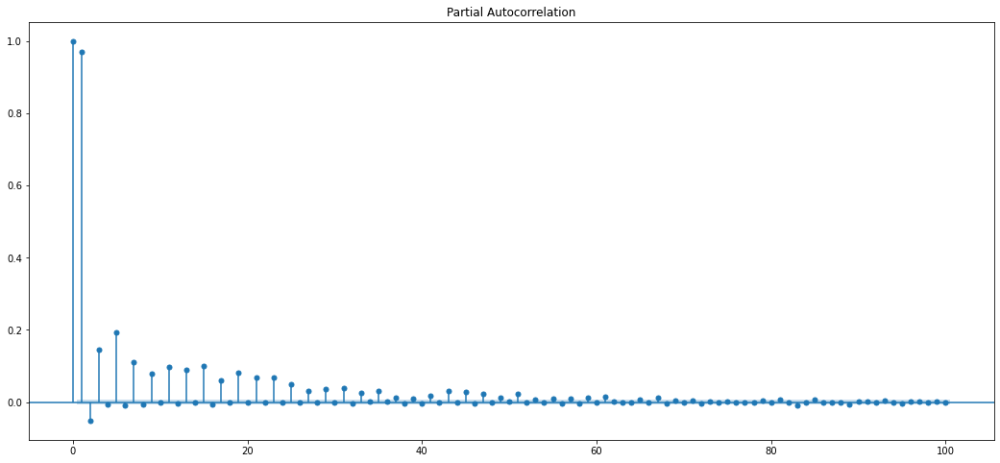

In [46]:
plot_acf(series_1, lags=100)
plot_pacf(series_1, lags=100)
plt.show()

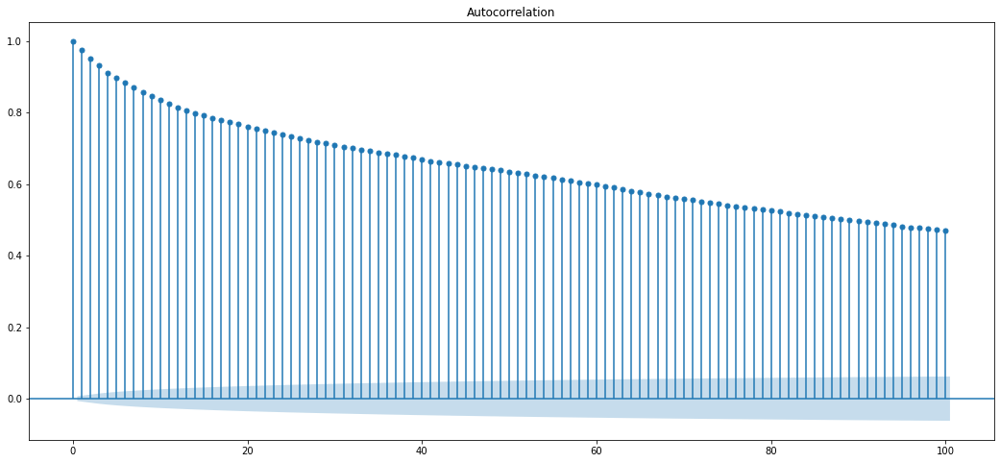

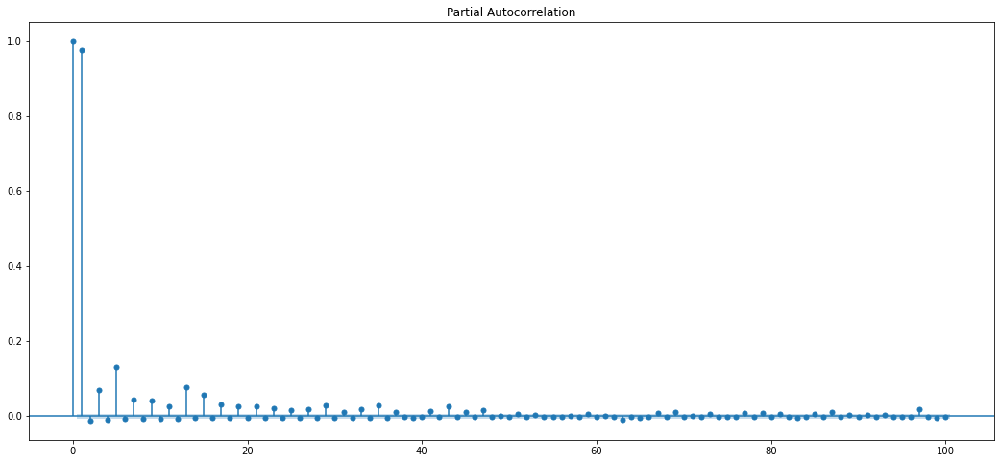

In [47]:
plot_acf(series_2, lags=100)
plot_pacf(series_2, lags=100)
plt.show()

In [48]:
X = series_1
result = adfuller(X)
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

ADF Statistic: -8.095908
p-value: 0.000000
Critical Values:
	1%: -3.430
	5%: -2.862
	10%: -2.567


In [49]:
X = series_2
result = adfuller(X)
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

ADF Statistic: -15.646445
p-value: 0.000000
Critical Values:
	1%: -3.430
	5%: -2.862
	10%: -2.567


In [50]:
df

,AC 1,AC 2,AC 3,AC 4,AC 5,AC 6,AC 7,AC 8,AC 9,AC 10,AC 11,AC 12,AC 13,AC 14,AC 15,AC 16,AC 17,AC 18,weekday,time,holiday,rain,temp,sum,avg_1,avg_2
time_block,,,,,,,,,,,,,,,,,,,,,,,,,,
2019-08-01 00:00:00,7.518632,8.788315,0.000000,0.000000,2.617045,4.079041,2.782276,4.624447,5.222060,2.151238,1.585072,0.560373,3.142941,2.749470,5.417774,4.113460,3.305072,6.735981,3,0,0,0.0,30.9869,65.393197,3.459509,5.020526
2019-08-01 00:01:00,7.426114,8.940615,0.000000,0.000000,2.581625,3.781231,2.529366,5.057423,5.349465,2.414715,2.168184,1.818730,3.085110,2.720484,3.302422,3.986483,3.220588,6.379500,3,1,0,0.0,30.9869,64.762056,3.447623,4.800044
2019-08-01 00:02:00,7.426114,8.940615,0.000000,0.000000,2.581625,3.781231,2.529366,5.057423,5.349465,2.414715,2.168184,1.818730,3.085110,2.720484,3.302422,3.986483,3.220588,6.379500,3,2,0,0.0,30.9869,64.762056,3.447623,4.800044
2019-08-01 00:03:00,7.052986,9.161103,0.000000,0.000000,2.592095,3.800127,2.332304,6.322521,3.995392,2.237114,3.345624,2.310409,3.132799,2.676861,3.539026,3.797881,3.131560,6.363475,3,3,0,0.0,30.9869,65.791277,3.518515,4.747518
2019-08-01 00:04:00,7.052986,9.161103,0.000000,0.000000,2.592095,3.800127,2.332304,6.322521,3.995392,2.237114,3.345624,2.310409,3.132799,2.676861,3.539026,3.797881,3.131560,6.363475,3,4,0,0.0,30.9869,65.791277,3.518515,4.747518
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-09-30 23:55:00,0.000000,6.122385,2.192198,2.083315,1.046250,0.000000,3.668421,3.006311,3.614301,1.860847,5.019769,3.154221,3.648026,2.439526,4.062719,1.854352,3.027539,7.259989,0,1435,0,0.0,26.4364,54.060166,2.735790,5.143764
2019-09-30 23:56:00,1.209176,6.152532,2.211421,0.000000,1.448103,0.000000,3.151248,2.871690,3.417942,2.185493,5.174168,2.772349,3.786657,2.060023,4.057525,1.870886,2.991946,7.134647,0,1436,0,0.0,26.4364,52.495807,2.648076,5.063297
2019-09-30 23:57:00,1.209176,6.152532,2.211421,0.000000,1.448103,0.000000,3.151248,2.871690,3.417942,2.185493,5.174168,2.772349,3.786657,2.060023,4.057525,1.870886,2.991946,7.134647,0,1437,0,0.0,26.4364,52.495807,2.648076,5.063297


In [51]:
#let's do the modelling for avg_1 replicate the model for all ACs

In [55]:
split_date = '2019-09-20 00:00:00'
df_training = df.loc[df.index < split_date]
df_test = df.loc[df.index >= split_date]
print(f"{len(df_training)} days of training data \n {len(df_test)} days of testing data ")

72000 days of training data 
 15840 days of testing data 


In [57]:
df_model=df[["weekday","time","holiday","rain","temp","avg_1","avg_2"]]

In [62]:
def create_time_features(df, target=None):
   
    
    if target:
        y = df[target]
        X = df.drop([target], axis=1)
        return X, y
    else:

        return X

In [67]:
resultsDict = {}
predictionsDict = {}

In [65]:
X_train_df, y_train = create_time_features(
    df_training.drop(["avg_2"],axis=1), target='avg_1')
X_test_df, y_test = create_time_features(df_test.drop(["avg_2"],axis=1), target="avg_1")
scaler = StandardScaler()
scaler.fit(X_train_df)  
X_train = scaler.transform(X_train_df)
X_test = scaler.transform(X_test_df)

X_train_df = pd.DataFrame(X_train, columns=X_train_df.columns)
X_test_df = pd.DataFrame(X_test, columns=X_test_df.columns)

In [80]:
lightGBM = lgb.LGBMRegressor()
lightGBM.fit(X_train, y_train)
yhat = lightGBM.predict(X_test)
resultsDict['Lightgbm'] = evaluate(df_test.avg_1.values, yhat)
predictionsDict['Lightgbm'] = yhat

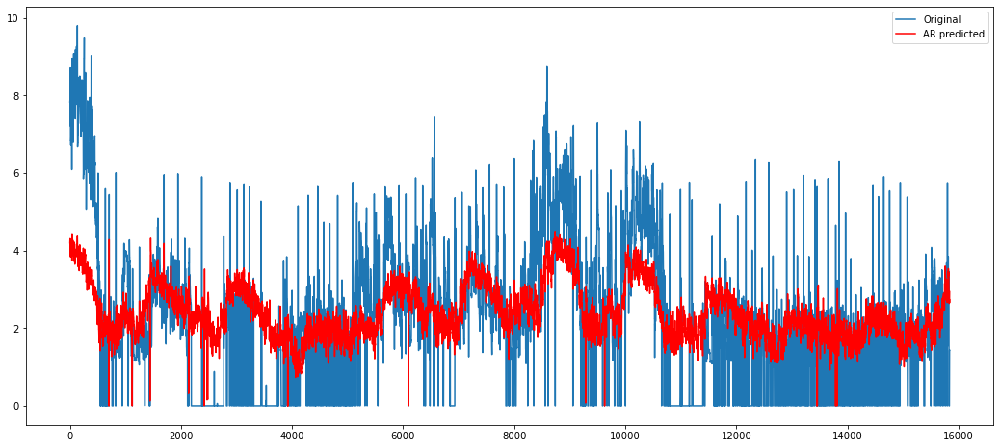

In [139]:
plt.plot(df_test["AC 1"].values, label='Original')
plt.plot(yhat, color='red', label='AR predicted')
plt.legend()

In [ ]:
#since LGBMRegressor is performing beautifully, we can apply this model for consumption prediction of every ACs

In [88]:
in_para=["weekday","time","holiday","rain","temp"]
out_para=['AC 1', 'AC 2', 'AC 3', 'AC 4', 'AC 5', 'AC 6', 'AC 7', 'AC 8', 'AC 9',
       'AC 10', 'AC 11', 'AC 12', 'AC 13', 'AC 14', 'AC 15', 'AC 16', 'AC 17',
       'AC 18']

In [89]:
model={}
for i in out_para:
    model[i]=lgb.LGBMRegressor()
    model[i].fit(df[in_para],df[i])
    

In [135]:

joblib.dump(model,"AC_model.pkl")

['AC_model.pkl']

In [116]:
x="2019-10-01"
t=21
r=0

In [94]:
d=pd.Timestamp(x)

In [98]:
mf=pd.DataFrame(range(1440),columns=["time"])

In [107]:
mf["time_block"]=pd.date_range(start=d,periods=1440,freq="T")

In [109]:
mf["holiday"]=0

In [111]:
mf["weekday"]=mf["time_block"].dt.weekday

In [113]:
mf.set_index('time_block', inplace=True)

In [117]:
mf["rain"]=r
mf["temp"]=t

In [120]:
mf=mf[["weekday","time","holiday","rain","temp"]]

In [128]:
res={}
for i in out_para:
    res[i]=model[i].predict(mf)
    

In [132]:
res=pd.DataFrame(res,index=mf.index)

In [133]:
res

,AC 1,AC 2,AC 3,AC 4,AC 5,AC 6,AC 7,AC 8,AC 9,AC 10,AC 11,AC 12,AC 13,AC 14,AC 15,AC 16,AC 17,AC 18
time_block,,,,,,,,,,,,,,,,,,
2019-10-01 00:00:00,1.543771,2.126292,2.636660,2.431860,1.150721,2.058220,1.711263,2.688314,2.459582,1.664831,2.619068,2.514971,4.254825,3.233048,3.587374,2.163279,3.778371,2.554208
2019-10-01 00:01:00,1.543771,2.126292,2.636660,2.431860,1.150721,2.058220,1.711263,2.688314,2.459582,1.664831,2.619068,2.514971,4.254825,3.233048,3.587374,2.163279,3.778371,2.554208
2019-10-01 00:02:00,1.543771,2.126292,2.636660,2.431860,1.150721,2.058220,1.711263,2.688314,2.459582,1.664831,2.619068,2.514971,4.254825,3.233048,3.587374,2.163279,3.778371,2.554208
2019-10-01 00:03:00,1.543771,2.126292,2.636660,2.431860,1.150721,2.058220,1.711263,2.688314,2.459582,1.664831,2.619068,2.514971,4.254825,3.233048,3.587374,2.163279,3.778371,2.554208
2019-10-01 00:04:00,1.543771,2.126292,2.636660,2.431860,1.150721,2.058220,1.711263,2.688314,2.459582,1.664831,2.619068,2.514971,4.254825,3.233048,3.587374,2.163279,3.778371,2.554208
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-10-01 23:55:00,3.062985,5.633172,2.627507,1.115753,0.867947,0.728662,2.970153,3.356448,4.337480,1.603955,4.468219,3.029278,4.561521,2.880314,3.955001,2.082241,3.127034,6.157073
2019-10-01 23:56:00,3.062985,5.633172,2.627507,1.115753,0.867947,0.728662,2.970153,3.356448,4.337480,1.603955,4.468219,3.029278,4.561521,2.880314,3.955001,2.082241,3.127034,6.157073
2019-10-01 23:57:00,3.062985,5.633172,2.627507,1.115753,0.867947,0.728662,2.970153,3.356448,4.337480,1.603955,4.468219,3.029278,4.561521,2.880314,3.955001,2.082241,3.127034,6.157073
